# 1. Importing dataset
- The dataset is extracted and computed from a SQLite database, and due to complexity and time reasons, the process of computing this dataset is done separately
- There are 2 target labels in this dataset:
    - `team_won` (either 0 or 1): specify which team won, 0 for team 1, 1 for team 2
    - `result`: the exact result of the match (ex: 2-0, 1-2,...)
- Most of the features here are compute in difference between 2 teams

In [12]:
import pandas as pd
import math

dataset = pd.read_csv("../data/dataset_v2.csv")
dataset = dataset.drop(
    columns=[
        "Unnamed: 0",
        "id",
        "url",
        "date",
        "tournament_id",
        "team_1_id",
        "team_2_id",
        "team_1_score",
        "team_2_score",
    ]
)

dataset = dataset.drop(columns=["result"])

def stage_encoding(row):
    if row["stage"] == "group_stage":
        return 0
    elif row["stage"] == "playoff":
        return 1
    elif row["stage"] == "grand_final":
        return 2



dataset["stage"] = dataset.apply(stage_encoding, axis=1)

dataset["rating_diff"] = dataset.apply(lambda row: math.log((row["team_1_rating"] + 1e-8) / (row["team_2_rating"] + 1e-8)), axis=1)
dataset["wr_diff"] = dataset.apply(lambda row: math.log((row["t1_wr"] + 1e-8) / (row["t2_wr"] + 1e-8)), axis=1)
dataset["avg_opps_rating_diff"] = dataset.apply(lambda row: math.log((row["t1_avg_opps_rating"] + 1e-8) / (row["t2_avg_opps_rating"] + 1e-8)), axis=1)
dataset["head_to_head"] = dataset.apply(lambda row: math.log((row["t1_wins_vs_t2"] + 1e-8) / (row["t2_wins_vs_t1"] + 1e-8)), axis=1)
dataset["indirect_head_to_head"] = dataset.apply(lambda row: math.log((row["t1_indirect_wins_vs_t2"] + 1e-8) / (row["t2_indirect_wins_vs_t1"] + 1e-8)), axis=1)
dataset["fks_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_fks_per_round"] + 1e-8) / (row["t2_fks_per_round"] + 1e-8)), axis=1)
dataset["fds_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_fds_per_round"] + 1e-8) / (row["t2_fds_per_round"] + 1e-8)), axis=1)
dataset["1v1s_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_1v1s_per_round"] + 1e-8) / (row["t2_1v1s_per_round"] + 1e-8)), axis=1)
dataset["1v2s_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_1v2s_per_round"] + 1e-8) / (row["t2_1v2s_per_round"] + 1e-8)), axis=1)
dataset["1v3s_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_1v3s_per_round"] + 1e-8) / (row["t2_1v3s_per_round"] + 1e-8)), axis=1)
dataset["1v4s_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_1v4s_per_round"] + 1e-8) / (row["t2_1v4s_per_round"] + 1e-8)), axis=1)
dataset["1v5s_per_round_diff"] = dataset.apply(lambda row: math.log((row["t1_1v5s_per_round"] + 1e-8) / (row["t2_1v5s_per_round"] + 1e-8)), axis=1)
dataset["2ks_converted_rate_diff"] = dataset.apply(lambda row: math.log((row["t1_2ks_converted_rate"] + 1e-8) / (row["t2_2ks_converted_rate"] + 1e-8)), axis=1)
dataset["3ks_converted_rate_diff"] = dataset.apply(lambda row: math.log((row["t1_3ks_converted_rate"] + 1e-8) / (row["t2_3ks_converted_rate"] + 1e-8)), axis=1)
dataset["4ks_converted_rate_diff"] = dataset.apply(lambda row: math.log((row["t1_4ks_converted_rate"] + 1e-8) / (row["t2_4ks_converted_rate"] + 1e-8)), axis=1)
dataset["5ks_converted_rate_diff"] = dataset.apply(lambda row: math.log((row["t1_5ks_converted_rate"] + 1e-8) / (row["t2_5ks_converted_rate"] + 1e-8)), axis=1)
dataset["avg_rounds_win_after_round_win_diff"] = dataset.apply(lambda row: math.log((row["t1_avg_rounds_win_after_round_win"] + 1e-8) / (row["t2_avg_rounds_win_after_round_win"] + 1e-8)), axis=1)
dataset["avg_rounds_loss_after_round_loss_diff"] = dataset.apply(lambda row: math.log((row["t1_avg_rounds_loss_after_round_loss"] + 1e-8) / (row["t2_avg_rounds_loss_after_round_loss"] + 1e-8)), axis=1)
dataset["wr_with_lead_diff"] = dataset.apply(lambda row: math.log((row["t1_wr_with_lead"] + 1e-8) / (row["t2_wr_with_lead"] + 1e-8)), axis=1)
dataset["wr_without_lead_diff"] = dataset.apply(lambda row: math.log((row["t1_wr_without_lead"] + 1e-8) / (row["t2_wr_without_lead"] + 1e-8)), axis=1)
dataset["key_round_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_key_round_wr"] + 1e-8) / (row["t2_key_round_wr"] + 1e-8)), axis=1)
dataset["pistol_round_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_pistol_round_wr"] + 1e-8) / (row["t2_pistol_round_wr"] + 1e-8)), axis=1)
dataset["eco_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_eco_wr"] + 1e-8) / (row["t2_eco_wr"] + 1e-8)), axis=1)
dataset["semi_eco_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_semi_eco_wr"] + 1e-8) / (row["t2_semi_eco_wr"] + 1e-8)), axis=1)
dataset["semi_buy_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_semi_buy_wr"] + 1e-8) / (row["t2_semi_buy_wr"] + 1e-8)), axis=1)
dataset["full_buy_wr_diff"] = dataset.apply(lambda row: math.log((row["t1_full_buy_wr"] + 1e-8) / (row["t2_full_buy_wr"] + 1e-8)), axis=1)

diff_dataset = dataset[
    [
        "team_won",
        "rating_diff",
        "wr_diff",
        "avg_opps_rating_diff",
        "head_to_head",
        "indirect_head_to_head",
        "fks_per_round_diff",
        "fds_per_round_diff",
        "1v1s_per_round_diff",
        "1v2s_per_round_diff",
        "1v3s_per_round_diff",
        "1v4s_per_round_diff",
        "1v5s_per_round_diff",
        "2ks_converted_rate_diff",
        "3ks_converted_rate_diff",
        "4ks_converted_rate_diff",
        "5ks_converted_rate_diff",
        "avg_rounds_win_after_round_win_diff",
        "avg_rounds_loss_after_round_loss_diff",
        "wr_with_lead_diff",
        "wr_without_lead_diff",
        "key_round_wr_diff",
        "pistol_round_wr_diff",
        "eco_wr_diff",
        "semi_eco_wr_diff",
        "semi_buy_wr_diff",
        "full_buy_wr_diff",
        "tier_1",
        "stage",
    ]
]

diff_dataset

,stage,tier_1,team_won,rating_diff,wr_diff,avg_opps_rating_diff,direct_hth,indirect_hth,maps_strength_diff,fk_per_round_diff,...,4ks_converted_rate_diff,5ks_converted_rate_diff,avg_rounds_win_after_round_win,avg_rounds_loss_after_round_loss,wr_with_lead_diff,wr_without_lead_diff,key_round_wr,clutches_per_round,mks_per_round,mks_converted_rate_diff
0,0,1,1,-742574.0,-0.145634,-209204.875000,0.000000,-8.987275,-0.261296,-0.010413,...,0.000215,0.000000,-0.039864,0.037567,-0.037341,-0.018662,-0.022932,0.001978,-0.028018,-0.026343
1,0,1,1,-427886.5,-0.140262,-138832.711058,-1.383596,2134.603259,-0.334968,-0.030959,...,-0.000409,-0.000053,-0.013365,0.046867,-0.028831,-0.037943,-0.016202,-0.000405,-0.013265,-0.010263
2,0,1,1,204406.5,0.006840,218305.504981,0.000000,136.250121,0.128482,-0.017290,...,-0.004320,0.000026,0.012889,0.018744,-0.008147,-0.001738,0.005598,0.000136,0.064837,-0.013046
3,0,1,1,235210.5,0.036490,-116052.440972,-2.828377,-77.963497,0.068358,0.036944,...,-0.000934,-0.000026,0.016327,0.006289,-0.010072,0.007679,0.006218,-0.000215,0.001801,0.009308
4,1,1,0,30999.5,0.032717,22078.621938,0.000000,24.972904,-0.177322,-0.004437,...,-0.002092,0.000033,0.002501,-0.036711,0.031879,0.000000,0.004679,0.000889,0.002260,0.010257
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4570,0,0,1,146157.5,0.128634,-52111.329627,1.482081,0.000000,0.057440,0.032749,...,-0.001560,-0.000032,0.038823,-0.019013,-0.018194,0.050250,0.005215,-0.000438,0.060569,0.002888
4571,0,0,1,242060.0,0.143587,20852.584336,0.498003,-88.477591,-0.028991,0.036937,...,0.000827,0.000006,0.024427,-0.065531,0.008364,0.035828,0.012969,0.000053,0.016834,0.014937
4572,0,0,0,-65920.0,-0.086427,130669.860000,0.000000,0.000000,0.311450,-0.006908,...,0.002889,0.000039,-0.024836,0.013517,-0.000800,-0.014889,-0.008451,0.000577,-0.051488,-0.009535
4573,0,0,1,-42432.0,0.033236,17937.941994,0.000000,0.000000,0.284874,0.007646,...,0.000114,-0.000015,0.008693,0.027599,-0.004285,0.023982,0.000671,0.001064,-0.001795,-0.003684


# 2. Data visualization
- First we will pair plot the dataset

In [14]:
import seaborn as sns 
import matplotlib.pyplot as plt

sns.pairplot(diff_dataset, hue="team_won")
plt.savefig("dataset_pair_plot.png")
plt.show()

# 3. Features importance analysis
- We will tree ensemble for this task.

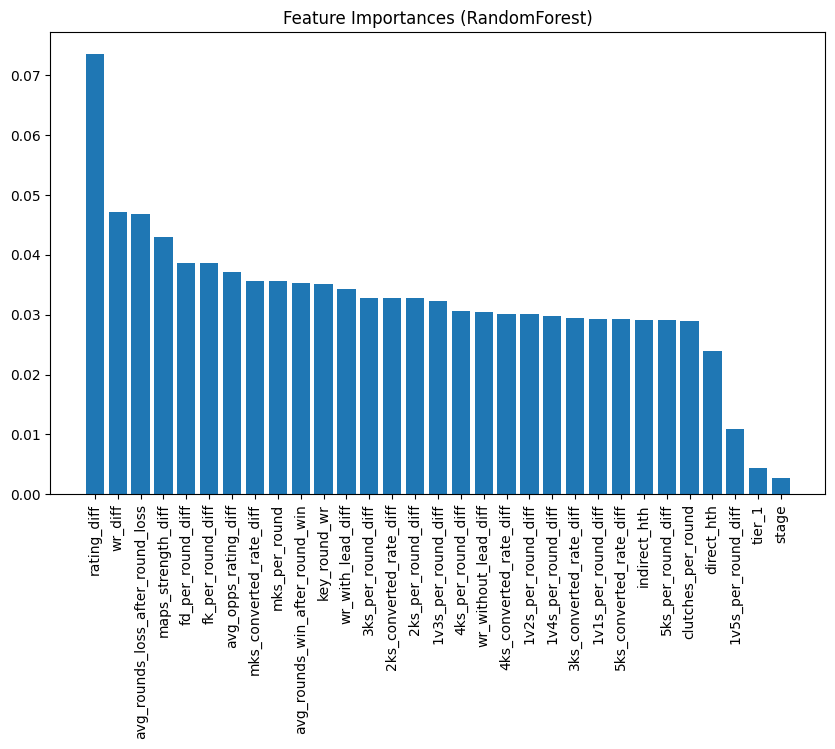

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import numpy as np

# Split to train & test
X = diff_dataset.drop(columns=["team_won"])
y = diff_dataset["team_won"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

model = RandomForestClassifier(
    n_estimators=200, random_state=42
)
model.fit(X_train, y_train)

importances = model.feature_importances_
indices = np.argsort(importances)[::-1]

plt.figure(figsize=(10,6))
plt.bar(range(X.shape[1]), importances[indices])
plt.xticks(range(X.shape[1]), X.columns[indices], rotation=90)
plt.title("Feature Importances (RandomForest)")
plt.tight_layout()
plt.savefig("feature_importances.png")
plt.show()